# C1 W4 Group 8 - Task 1


In [1]:
from PIL import Image
from tqdm import tqdm
import cv2
import numpy as np
from src.data import AUGMENTATIONS_QSD1_W4_LIST, FRAMES_QSD1_W4_LIST, GT_QSD1_W4_LIST
from src.paths import BBDD_PATH, QSD1_W4_PATH, QSD1_NON_AUGMENTED_W4_PATH, WEEK_4_RESULTS_PATH
import matplotlib.pyplot as plt

In [2]:
BBDD_PATH_LIST = sorted(BBDD_PATH.glob("*.jpg"))
QSD1_W4_PATH_LIST = sorted(QSD1_W4_PATH.glob("*.jpg"))
QSD1_NON_AUGMENTED_W4_PATH_LIST = sorted(QSD1_NON_AUGMENTED_W4_PATH.glob("*.jpg"))

In [3]:
database_image_PIL_list = [Image.open(db_img_path) for db_img_path in BBDD_PATH_LIST]  # Load once
for idx, db_img in enumerate(database_image_PIL_list):
    assert db_img.filename.endswith(f"{idx}.jpg")

In [4]:
query_d1_image_PIL_list = [Image.open(query_img_path) for query_img_path in QSD1_W4_PATH_LIST]  # Load once
for idx, query_img in enumerate(query_d1_image_PIL_list):
    assert query_img.filename.endswith(f"{idx}.jpg")

In [5]:
non_augmented_d1_image_PIL_list = [Image.open(query_img_path) for query_img_path in QSD1_NON_AUGMENTED_W4_PATH_LIST]  # Load once
for idx, query_img in enumerate(non_augmented_d1_image_PIL_list):
    assert query_img.filename.endswith(f"{idx}.jpg")

In [6]:
for file, augmentation, frames, gt in zip(QSD1_W4_PATH_LIST, AUGMENTATIONS_QSD1_W4_LIST, FRAMES_QSD1_W4_LIST, GT_QSD1_W4_LIST):
    frame_info = "; ".join([f"({frame[0]:.2f}, {frame[1]})" for frame in frames])
    print(f"File={file.stem}, Aug={augmentation}, Frames={frame_info}, GT={gt}")

File=00000, Aug=None, Frames=(179.50, [[64, 41], [2048, 25], [2016, 3653], [196, 3637]]), GT=[-1]
File=00001, Aug=None-MultiplyHue, Frames=(179.52, [[19, 38], [509, 37], [496, 665], [17, 661]]), GT=[150]
File=00002, Aug=None-MultiplyHue, Frames=(0.95, [[34, 50], [396, 32], [408, 470], [46, 476]]); (0.30, [[466, 34], [844, 20], [850, 484], [470, 486]]), GT=[48, 251]
File=00003, Aug=UnnamedImpulseNoise, Frames=(180.00, [[24, 27], [458, 26], [462, 355], [45, 355]]), GT=[32]
File=00004, Aug=None-MultiplyHue, Frames=(0.48, [[53, 78], [1489, 62], [1497, 2326], [77, 2338]]), GT=[161]
File=00005, Aug=None, Frames=(179.85, [[50, 43], [1642, 27], [1646, 2051], [82, 2047]]), GT=[81]
File=00006, Aug=None, Frames=(1.55, [[176, 46], [470, 34], [478, 326], [182, 334]]); (1.35, [[48, 416], [478, 398], [484, 778], [60, 788]]), GT=[62, 38]
File=00007, Aug=None-MultiplyHue, Frames=(0.54, [[53, 32], [1365, 36], [1329, 2492], [53, 2504]]), GT=[-1]
File=00008, Aug=UnnamedImpulseNoise, Frames=(179.72, [[65, 

## Research : Denoising over the images

In [7]:
from src.denoising import denoise_image

In [8]:
# Median filter
denoised_query_d1_PIL_list = [denoise_image(image) for image in query_d1_image_PIL_list]

In [9]:
def plot_images_with_multiple_filters(original_images, noisy_images, denoised_images, save_path):
    num_images = len(original_images)
    num_cols = 3
    fig, axes = plt.subplots(num_images, num_cols, figsize=(25, 5 * num_images))  # +1 for original image

    for i in range(num_images):
        original_image = original_images[i]
        noisy_image = noisy_images[i]

        axes[i, 0].imshow(original_image)
        axes[i, 0].set_title(f'Original Image {i+1}')
        axes[i, 0].axis('off')

        axes[i, 1].imshow(noisy_image)
        axes[i, 1].set_title(f'Noisy image Image {i+1}')
        axes[i, 1].axis('off')

        axes[i, 2].imshow(denoised_images[i])
        axes[i, 2].set_title(f'Denoised {i+1}')
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.savefig(save_path)
    plt.close()

In [10]:

#plot_images_with_multiple_filters(non_augmented_d1_image_PIL_list, query_d1_image_PIL_list, denoised_query_d1_PIL_list, WEEK_4_RESULTS_PATH / "Task_1"/ 'denoised_images_plot.png')

## Research : Background removal

In [11]:
from src.background import get_painting_masks, crop_image_by_mask

def crop_paintings_from_image(image, ground_truth):
    image_np = np.array(image)
    cropped_images = []

    for points in (entry[1] for entry in ground_truth):
        src_points = np.array(points, dtype=np.float32)
        width, height = map(int, [np.linalg.norm(src_points[1] - src_points[0]), np.linalg.norm(src_points[2] - src_points[1])])
        dst_points = np.array([[0, 0], [width, 0], [width, height], [0, height]], dtype=np.float32)

        M = cv2.getPerspectiveTransform(src_points, dst_points)
        cropped_images.append(Image.fromarray(cv2.warpPerspective(image_np, M, (width, height))))

    return cropped_images

In [12]:
cropped_query_image_list_d1 = []
pbar = tqdm(zip(sorted(QSD1_W4_PATH.glob("*.jpg")), denoised_query_d1_PIL_list, FRAMES_QSD1_W4_LIST))
for name, image, predicted_mask in pbar:
    pbar.set_description(f"Splitting {name.stem}")
    cropped_query_image_list_d1.append(crop_paintings_from_image(image, predicted_mask))

Splitting 00029: : 30it [00:00, 84.75it/s]


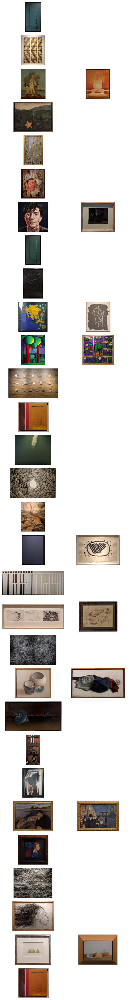

In [13]:
n_rows = len(cropped_query_image_list_d1)

fig, axes = plt.subplots(n_rows, 2, figsize=(6, n_rows *1.5))

for ax, l in zip(axes, cropped_query_image_list_d1):
    ax[0].imshow(l[0]); ax[0].axis('off')
    if len(l) > 1:
        ax[1].imshow(l[1])
    ax[1].axis('off')

plt.tight_layout()
plt.show()

## Research : Keypoint extraction

In [14]:
from src.descriptors import SIFTDescriptor, ORBDescriptor, HOGDescriptor, ImageRetrievalSystem

In [28]:
# denoise also dataset ?
denoise_database_image = [image for image in database_image_PIL_list]

In [29]:
descriptors = {
    'SIFT': SIFTDescriptor(max_features=500),
   # 'ORB': ORBDescriptor(),
   # 'HOG': HOGDescriptor()
}
descriptor_path = WEEK_4_RESULTS_PATH / 'Task_1' / 'descriptors'  

In [30]:
# Set number of top similar images to retrieve
K = 10

results = {}
g_0 = {}

# FLANN parameters
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks=50)   # or pass empty dictionary
 
flann = cv2.FlannBasedMatcher(index_params,search_params)
museum_descriptors = [descriptors['SIFT'].compute(np.array(museum_img)) for museum_img in tqdm(denoise_database_image)]

100%|██████████| 287/287 [01:48<00:00,  2.66it/s]


In [31]:
def display_result(query, result, gt, gt_idx):
    """
    Displays three rows of images:
    - First row: Original query, result, and ground truth images.
    - Second row: Matches between query and result in both directions.
    - Third row: Matches between query and ground truth in both directions.

    Parameters:
    - query: The query image.
    - result: The result image.
    - gt: The ground truth image.
    - descriptor: The descriptor type to use, default is 'SIFT'.
    """
    # Initialize SIFT detector
    sift = cv2.SIFT_create()

    # Compute keypoints and descriptors
    kp1, des1 = sift.detectAndCompute(query, None)
    kp2, des2 = sift.detectAndCompute(result, None)
    kp3, des3 = sift.detectAndCompute(gt, None)

    def get_good_matches(des_a, des_b):
        matches = flann.knnMatch(des_a, des_b, k=2)
        good = []
        for m, n in matches:
            if m.distance < 0.75 * n.distance:
                good.append([m])
        return matches, good

    def draw_matches(img_a, kp_a, img_b, kp_b, matches):
        # Mask for drawing only good matches
        matches_mask = [[0, 0] for _ in range(len(matches))]
        for i, (m, n) in enumerate(matches):
            if m.distance < 0.7 * n.distance:
                matches_mask[i] = [1, 0]
        
        draw_params = dict(matchColor=(0, 255, 0),  # Green lines for matches
                           singlePointColor=(255, 0, 0),  # Red points for single points
                           matchesMask=matches_mask,
                           flags=cv2.DrawMatchesFlags_DEFAULT)
        return cv2.drawMatchesKnn(img_a, kp_a, img_b, kp_b, matches, None, **draw_params)

    # First row - Original images
    fig, axs = plt.subplots(3, 3, figsize=(15, 15))
    axs[0, 0].imshow(query, cmap='gray')
    axs[0, 0].set_title("Query Image")
    axs[0, 0].axis('off')

    axs[0, 1].imshow(result, cmap='gray')
    axs[0, 1].set_title("Result Image")
    axs[0, 1].axis('off')

    if gt_idx != -1:
        axs[0, 2].imshow(gt, cmap='gray')
        axs[0, 2].set_title("Ground Truth Image")
        axs[0, 2].axis('off')

    # Second row - Query <-> Result matches
    matches_q_to_r, good_q_to_r = get_good_matches(des1, des2)
    img_q_to_r = draw_matches(query, kp1, result, kp2, matches_q_to_r)
    axs[1, 0].imshow(img_q_to_r)
    axs[1, 0].set_title("Query to Result")
    axs[1, 0].axis('off')

    matches_r_to_q, good_r_to_q = get_good_matches(des2, des1)
    img_r_to_q = draw_matches(result, kp2, query, kp1, matches_r_to_q)
    axs[1, 1].imshow(img_r_to_q)
    axs[1, 1].set_title("Result to Query")
    axs[1, 1].axis('off')

    if gt_idx != -1:
        # Third row - Query <-> Ground Truth matches
        matches_q_to_gt, good_q_to_gt = get_good_matches(des1, des3)
        img_q_to_gt = draw_matches(query, kp1, gt, kp3, matches_q_to_gt)
        axs[2, 0].imshow(img_q_to_gt)
        axs[2, 0].set_title("Query to Ground Truth")
        axs[2, 0].axis('off')
    
        matches_gt_to_q, good_gt_to_q = get_good_matches(des3, des1)
        img_gt_to_q = draw_matches(gt, kp3, query, kp1, matches_gt_to_q)
        axs[2, 1].imshow(img_gt_to_q)
        axs[2, 1].set_title("Ground Truth to Query")
        axs[2, 1].axis('off')

        # Hide unused subplot in the last row
        axs[1, 2].axis('off')
        axs[2, 2].axis('off')
    
    plt.tight_layout()
    plt.show()


Retrieving similar images using SIFT descriptor:
Query 0
 - Image 0


287it [00:29,  9.74it/s]


   - Relative gap:  0.009389671361502375
Ambiguous result detected


287it [00:36,  7.91it/s]


Detected as not found
 Results : (-1, 1)
 GT : -1
############


Query 1
 - Image 0


287it [00:19, 14.77it/s]


   - Relative gap:  0.599250936329588
 Results : (150, 0.213258785942492)
 GT : 150
############


Query 2
 - Image 0


287it [00:16, 17.05it/s]


   - Relative gap:  0.9423076923076923
 Results : (48, 0.4896421845574388)
 GT : 48
############


 - Image 1


287it [00:15, 18.24it/s]


   - Relative gap:  0.7377049180327869
 Results : (251, 0.3961038961038961)
 GT : 251
############


Query 3
 - Image 0


287it [00:16, 17.77it/s]


   - Relative gap:  0.44
 Results : (32, 0.2032520325203252)
 GT : 32
############


Query 4
 - Image 0


287it [01:06,  4.32it/s]


   - Relative gap:  0.9121552604698673
 Results : (161, 0.3246738890117179)
 GT : 161
############


Query 5
 - Image 0


287it [00:34,  8.23it/s]


   - Relative gap:  0.900043840420868
 Results : (81, 0.32772988505747125)
 GT : 81
############


Query 6
 - Image 0


287it [00:17, 16.31it/s]


   - Relative gap:  0.9367469879518073
 Results : (62, 0.3738738738738739)
 GT : 62
############


 - Image 1


287it [00:15, 18.51it/s]


   - Relative gap:  0.53125
 Results : (38, 0.29906542056074764)
 GT : 38
############


Query 7
 - Image 0


287it [00:17, 15.97it/s]


   - Relative gap:  0.12328767123287666
Ambiguous result detected


287it [00:34,  8.24it/s]


Detected as not found
 Results : (-1, 1)
 GT : -1
############


Query 8
 - Image 0


287it [00:16, 17.10it/s]


   - Relative gap:  0.1315789473684211
Ambiguous result detected


287it [00:34,  8.21it/s]


Detected as not found
 Results : (-1, 1)
 GT : 128
MEEEEEC
[(67, 0.12337662337662338), (53, 0.10714285714285714), (150, 0.08766233766233766), (211, 0.07467532467532467), (263, 0.06818181818181818), (107, 0.06493506493506493), (36, 0.06168831168831169), (229, 0.06168831168831169), (204, 0.05844155844155844), (236, 0.05844155844155844), (11, 0.05519480519480519), (59, 0.05519480519480519), (101, 0.05194805194805195), (128, 0.05194805194805195), (175, 0.05194805194805195), (141, 0.048701298701298704), (148, 0.048701298701298704), (152, 0.048701298701298704), (208, 0.048701298701298704), (252, 0.048701298701298704), (43, 0.045454545454545456), (115, 0.045454545454545456), (197, 0.045454545454545456), (285, 0.045454545454545456), (6, 0.04220779220779221), (17, 0.04220779220779221), (118, 0.04220779220779221), (189, 0.04220779220779221), (219, 0.04220779220779221), (19, 0.03896103896103896), (20, 0.03896103896103896), (79, 0.03896103896103896), (93, 0.03896103896103896), (97, 0.0389610389610

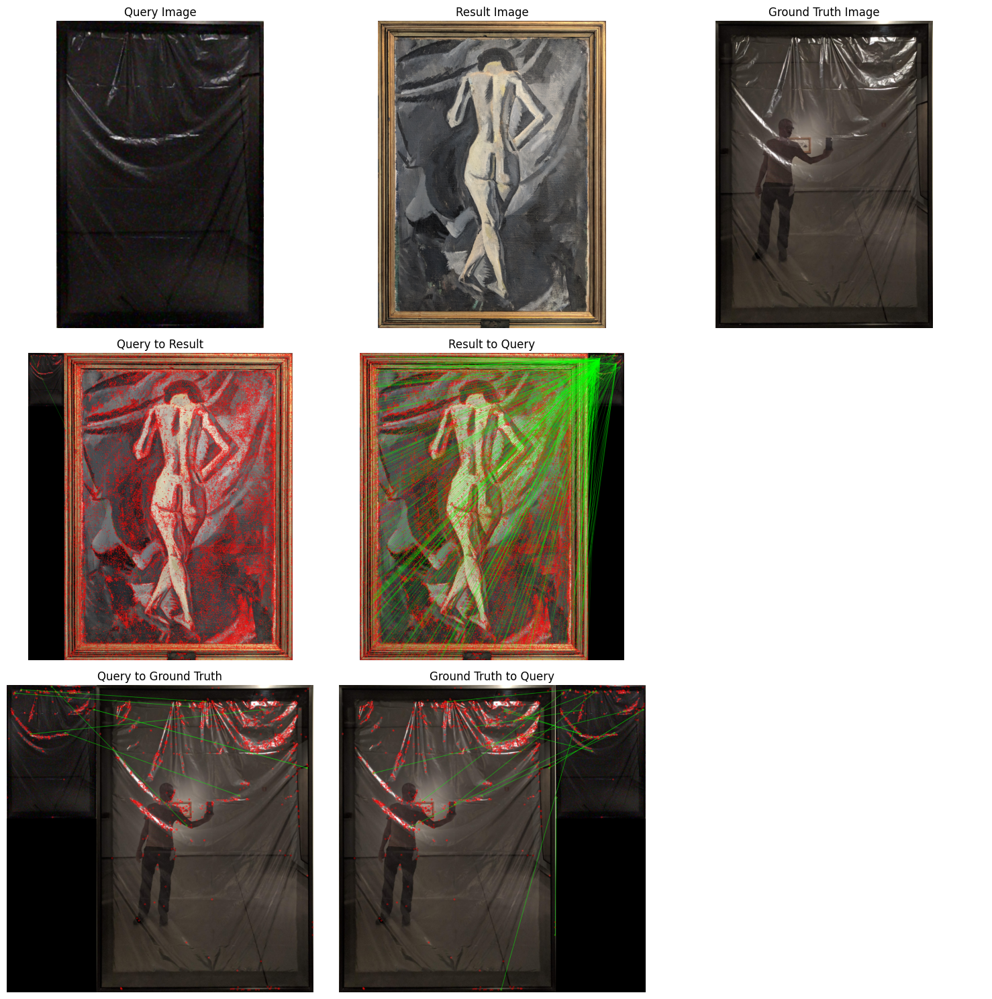

############


Query 9
 - Image 0


287it [00:30,  9.45it/s]


   - Relative gap:  0.8835616438356165
 Results : (155, 0.238562091503268)
 GT : 155
############


 - Image 1


287it [00:19, 15.06it/s]


   - Relative gap:  0.7142857142857142
 Results : (258, 0.3575268817204301)
 GT : 258
############


Query 10
 - Image 0


287it [00:18, 15.81it/s]


   - Relative gap:  0.776978417266187
 Results : (136, 0.21583850931677018)
 GT : 136
############


 - Image 1


287it [00:23, 12.24it/s]


   - Relative gap:  0.8922018348623854
 Results : (76, 0.3202350348879912)
 GT : 76
############


Query 11
 - Image 0


287it [01:50,  2.59it/s]


   - Relative gap:  0.09638554216867476
Ambiguous result detected


287it [01:22,  3.49it/s]


 Results : (-1, 1)
 GT : -1
############


Query 12
 - Image 0


287it [00:21, 13.17it/s]


   - Relative gap:  0.20673076923076925
 Results : (-1, 1)
 GT : -1
############


Query 13
 - Image 0


287it [00:15, 18.44it/s]


   - Relative gap:  0.9230769230769231
 Results : (53, 0.6)
 GT : 53
############


Query 14
 - Image 0


287it [01:42,  2.80it/s]


   - Relative gap:  0.4007490636704119
 Results : (-1, 1)
 GT : -1
############


Query 15
 - Image 0


287it [00:24, 11.59it/s]


   - Relative gap:  0.9650455927051672
 Results : (12, 0.3885444346028934)
 GT : 12
############


Query 16
 - Image 0


287it [00:15, 18.65it/s]


   - Relative gap:  0.1
Ambiguous result detected


287it [00:15, 18.75it/s]


Detected as not found
 Results : (-1, 1)
 GT : 11
MEEEEEC
[(47, 0.625), (145, 0.5625), (18, 0.5), (95, 0.5), (97, 0.5), (181, 0.5), (189, 0.5), (224, 0.5), (270, 0.5), (27, 0.4375), (46, 0.4375), (75, 0.4375), (131, 0.4375), (245, 0.4375), (251, 0.4375), (64, 0.375), (102, 0.375), (146, 0.375), (172, 0.375), (178, 0.375), (179, 0.375), (183, 0.375), (204, 0.375), (216, 0.375), (269, 0.375), (6, 0.3125), (81, 0.3125), (90, 0.3125), (108, 0.3125), (127, 0.3125), (128, 0.3125), (147, 0.3125), (158, 0.3125), (159, 0.3125), (199, 0.3125), (241, 0.3125), (257, 0.3125), (261, 0.3125), (268, 0.3125), (20, 0.25), (24, 0.25), (25, 0.25), (33, 0.25), (38, 0.25), (40, 0.25), (60, 0.25), (68, 0.25), (85, 0.25), (87, 0.25), (92, 0.25), (106, 0.25), (114, 0.25), (137, 0.25), (166, 0.25), (180, 0.25), (188, 0.25), (201, 0.25), (210, 0.25), (212, 0.25), (222, 0.25), (229, 0.25), (234, 0.25), (242, 0.25), (246, 0.25), (258, 0.25), (280, 0.25), (5, 0.1875), (7, 0.1875), (15, 0.1875), (17, 0.1875), (36, 0

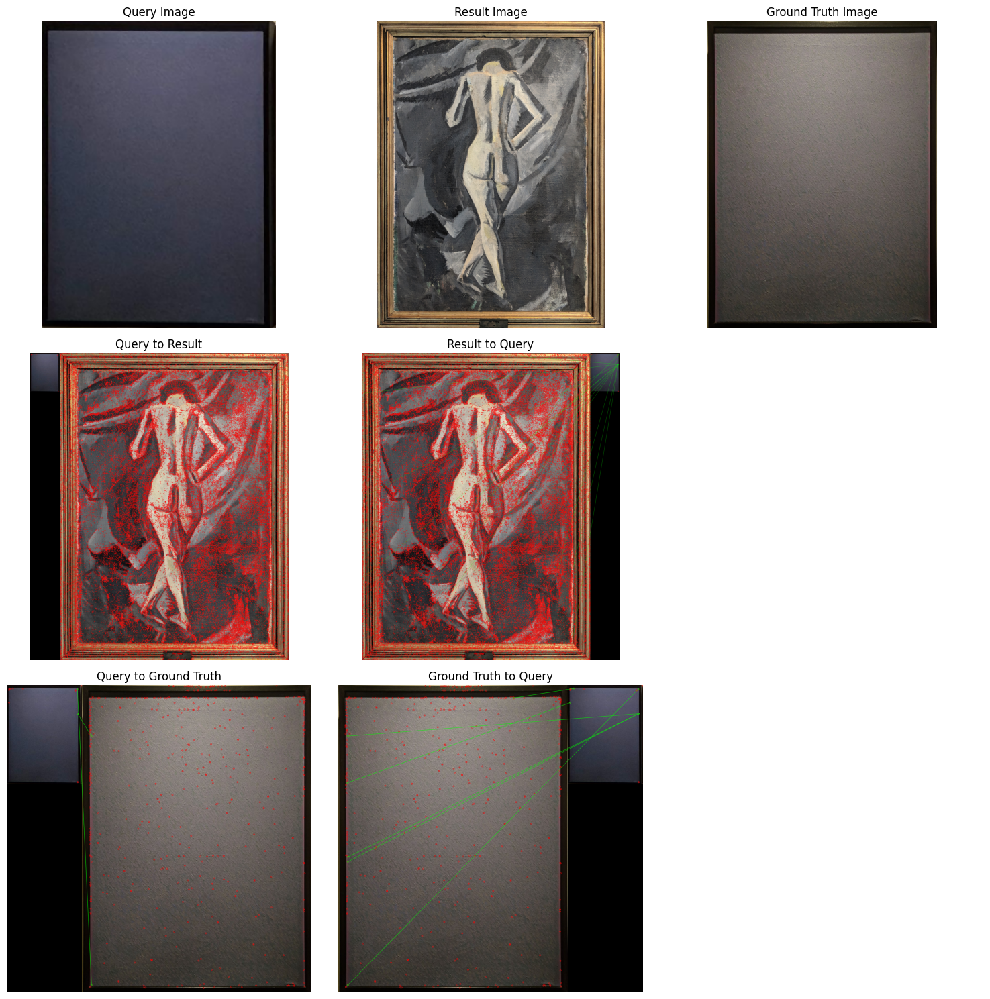

############


 - Image 1


287it [00:15, 18.18it/s]


   - Relative gap:  0.84375
 Results : (280, 0.5303867403314917)
 GT : 280
############


Query 17
 - Image 0


287it [00:22, 12.93it/s]


   - Relative gap:  0.23907455012853474
 Results : (128, 0.32148760330578513)
 GT : -1
MEEEEEC
[(128, 0.32148760330578513), (268, 0.24462809917355371), (219, 0.24421487603305786), (75, 0.24008264462809917), (213, 0.21446280991735536), (157, 0.19834710743801653), (100, 0.19793388429752065), (204, 0.19586776859504132), (56, 0.19297520661157025), (47, 0.18925619834710744), (269, 0.18884297520661156), (243, 0.18512396694214875), (62, 0.17355371900826447), (112, 0.1628099173553719), (238, 0.15991735537190083), (36, 0.1578512396694215), (205, 0.15661157024793387), (22, 0.15206611570247933), (144, 0.15206611570247933), (53, 0.1446280991735537), (118, 0.1446280991735537), (165, 0.14421487603305785), (91, 0.14380165289256197), (146, 0.14297520661157026), (138, 0.14173553719008264), (49, 0.13925619834710745), (114, 0.13925619834710745), (7, 0.1384297520661157), (131, 0.1371900826446281), (38, 0.13429752066115702), (222, 0.1309917355371901), (170, 0.12975206611570247), (209, 0.12520661157024793),

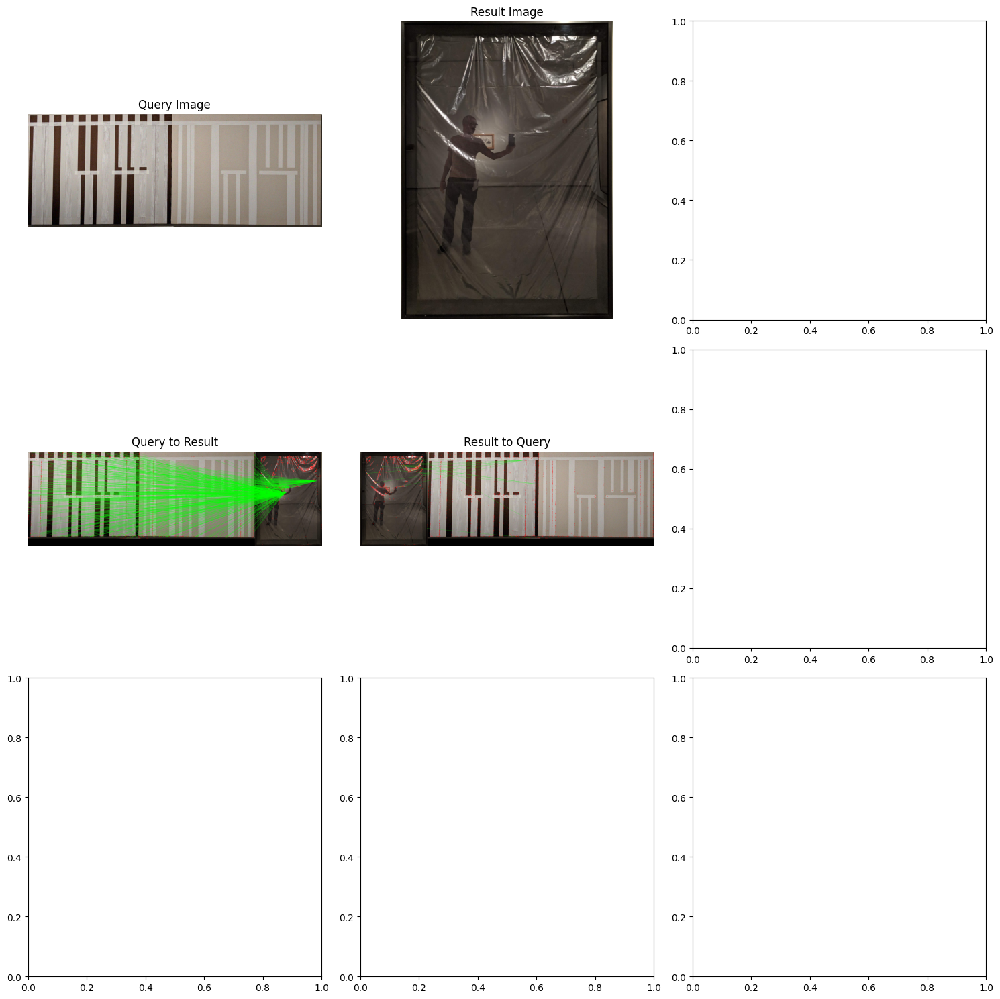

############


Query 18
 - Image 0


287it [00:17, 16.37it/s]


   - Relative gap:  0.8878504672897196
 Results : (182, 0.35081967213114756)
 GT : 182
############


 - Image 1


287it [00:16, 17.00it/s]


   - Relative gap:  0.59375
 Results : (252, 0.21694915254237288)
 GT : 252
############


Query 19
 - Image 0


287it [03:59,  1.20it/s]


   - Relative gap:  0.07197809362367981
Ambiguous result detected


287it [02:24,  1.99it/s]


Detected as not found
 Results : (-1, 1)
 GT : -1
############


Query 20
 - Image 0


287it [00:15, 18.13it/s]


   - Relative gap:  0.6986301369863014
 Results : (272, 0.6239316239316239)
 GT : 272
############


 - Image 1


287it [00:16, 17.29it/s]


   - Relative gap:  0.8541666666666667
 Results : (117, 0.5065963060686016)
 GT : 117
############


Query 21
 - Image 0


287it [00:16, 17.13it/s]


   - Relative gap:  0.25
 Results : (204, 0.12474012474012475)
 GT : -1
MEEEEEC
[(204, 0.12474012474012475), (270, 0.09355509355509356), (263, 0.08523908523908524), (13, 0.06860706860706861), (90, 0.06652806652806653), (199, 0.06652806652806653), (282, 0.06652806652806653), (53, 0.06444906444906445), (150, 0.06444906444906445), (255, 0.062370062370062374), (148, 0.060291060291060294), (177, 0.060291060291060294), (118, 0.058212058212058215), (209, 0.058212058212058215), (38, 0.056133056133056136), (43, 0.056133056133056136), (75, 0.056133056133056136), (59, 0.05405405405405406), (102, 0.05405405405405406), (261, 0.05405405405405406), (15, 0.05197505197505198), (62, 0.05197505197505198), (124, 0.05197505197505198), (222, 0.05197505197505198), (228, 0.05197505197505198), (80, 0.0498960498960499), (131, 0.0498960498960499), (257, 0.0498960498960499), (6, 0.04781704781704782), (42, 0.04781704781704782), (77, 0.04781704781704782), (242, 0.04781704781704782), (121, 0.04573804573804574), (152

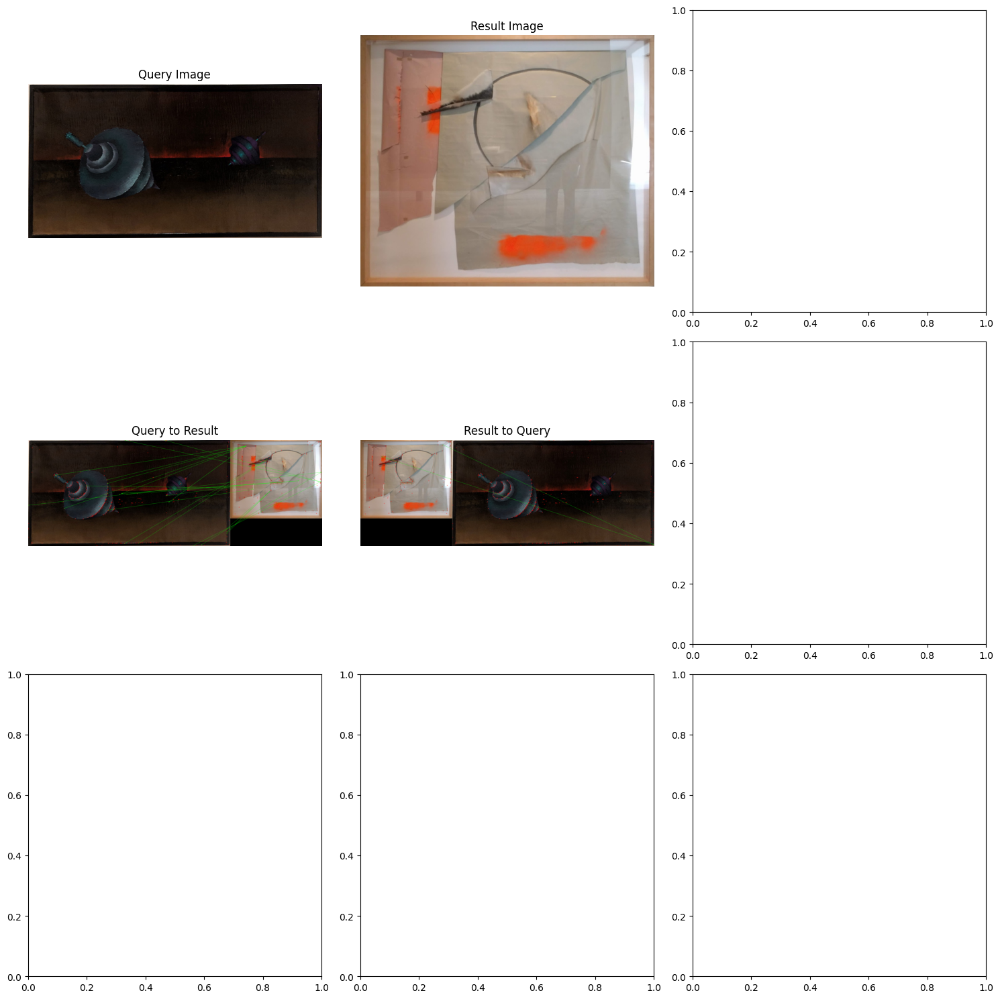

############


Query 22
 - Image 0


287it [00:19, 14.77it/s]


   - Relative gap:  0.8961937716262977
 Results : (242, 0.3172338090010977)
 GT : 242
############


Query 23
 - Image 0


287it [00:35,  8.03it/s]


   - Relative gap:  0.4098654708520179
 Results : (260, 0.16567607726597325)
 GT : 260
############


Query 24
 - Image 0


287it [00:18, 15.69it/s]


   - Relative gap:  0.4583333333333334
 Results : (94, 0.1359773371104816)
 GT : 94
############


 - Image 1


287it [00:26, 10.96it/s]


   - Relative gap:  0.7291280148423006
 Results : (132, 0.14698663757840197)
 GT : 132
############


Query 25
 - Image 0


287it [00:15, 17.95it/s]


   - Relative gap:  0.5185185185185185
 Results : (223, 0.11894273127753303)
 GT : 223
############


Query 26
 - Image 0


287it [06:19,  1.32s/it]


   - Relative gap:  0.13730853391684894
Ambiguous result detected


287it [03:46,  1.26it/s]


 Results : (-1, 1)
 GT : -1
############


Query 27
 - Image 0


287it [00:28, 10.08it/s]


   - Relative gap:  0.935656836461126
 Results : (127, 0.3033753558357056)
 GT : 127
############


Query 28
 - Image 0


287it [00:20, 14.07it/s]


   - Relative gap:  0.029411764705882366
Ambiguous result detected


287it [00:36,  7.80it/s]


Detected as not found
 Results : (-1, 1)
 GT : 47
MEEEEEC
[(211, 0.11805555555555555), (144, 0.11458333333333333), (42, 0.1111111111111111), (236, 0.1076388888888889), (157, 0.10069444444444445), (181, 0.09722222222222222), (13, 0.09375), (47, 0.09375), (223, 0.09375), (202, 0.09027777777777778), (209, 0.09027777777777778), (90, 0.08680555555555555), (150, 0.08680555555555555), (165, 0.08680555555555555), (178, 0.08680555555555555), (240, 0.08333333333333333), (8, 0.0798611111111111), (189, 0.0798611111111111), (4, 0.07291666666666667), (67, 0.07291666666666667), (37, 0.06944444444444445), (141, 0.06944444444444445), (285, 0.06944444444444445), (49, 0.06597222222222222), (134, 0.06597222222222222), (270, 0.06597222222222222), (19, 0.0625), (43, 0.0625), (231, 0.0625), (268, 0.0625), (25, 0.059027777777777776), (44, 0.059027777777777776), (73, 0.059027777777777776), (115, 0.059027777777777776), (145, 0.059027777777777776), (224, 0.059027777777777776), (52, 0.05555555555555555), (97, 0.0

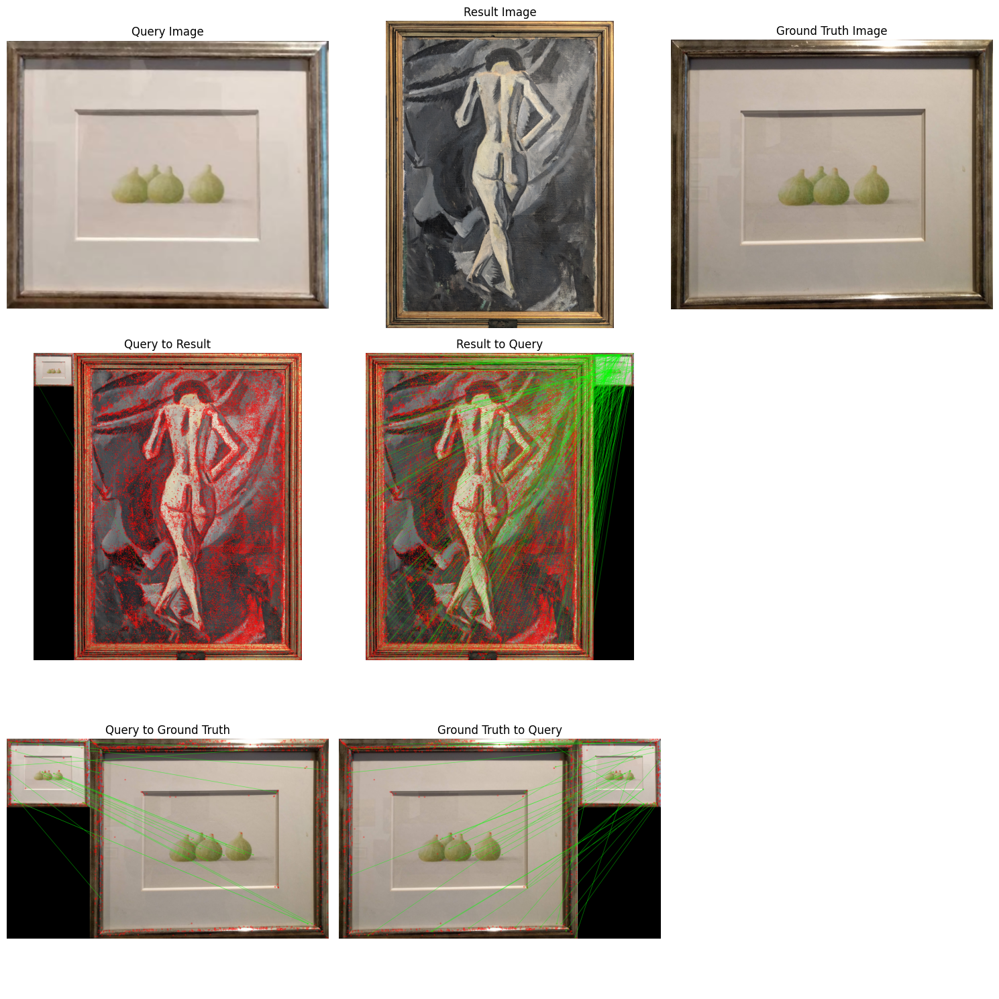

############


 - Image 1


287it [00:22, 12.86it/s]


   - Relative gap:  0.6874999999999999
 Results : (13, 0.4752475247524752)
 GT : 13
############


Query 29
 - Image 0


287it [00:44,  6.47it/s]


   - Relative gap:  0.08235294117647061
Ambiguous result detected


287it [00:48,  5.94it/s]

 Results : (-1, 1)
 GT : -1
############




In [34]:
results = []
for descriptor_name in descriptors.keys():
    print(f"\nRetrieving similar images using {descriptor_name} descriptor:")
    for idx, (query_images, gt_tuple) in enumerate(zip(cropped_query_image_list_d1, GT_QSD1_W4_LIST)):
        print(f"Query {idx}")
        query_result = []
        
        #if idx not in [8,14,16,24,25,28]:
            #continue
        for img_idx, image in enumerate(query_images):   
            print(f" - Image {img_idx}")
            best_candidate = []
            img_results = []
            query_descriptor = descriptors[descriptor_name].compute(np.array(image))
            for museum_idx, db_descriptor in tqdm(enumerate(museum_descriptors)):
                if db_descriptor[1] is None:
                    continue
                matches = flann.knnMatch(query_descriptor[1], db_descriptor[1],k=2)
                good = []
                for m,n in matches:
                    if m.distance < 0.75*n.distance:
                        good.append([m])
                similarity_score = len(good) / len(matches) if matches else 0
                img_results.append((museum_idx, similarity_score))
            
            img_results.sort(key=lambda x: x[1], reverse=True)
            
            second_score = 0
            top_score = 0
            if len(img_results) > 1:
                top_score = img_results[0][1]
                second_score = img_results[1][1]
                
                # Check relative gap threshold (e.g., less than 10% difference)
                relative_gap = (top_score - second_score) / top_score if top_score > 0 else 0
                print("   - Relative gap: ", relative_gap)
                ambiguous = relative_gap < 0.2
                               
            else:
                ambiguous = False
            
            # If ambiguous, perform reverse matching (db -> query)
            if ambiguous:
                print("Ambiguous result detected")
                reverse_results = []
                for museum_idx, db_descriptor in tqdm(enumerate(museum_descriptors)):
                    if db_descriptor[1] is None:
                        continue
                    reverse_matches = flann.knnMatch(db_descriptor[1], query_descriptor[1], k=2)
                    good_reverse = []
                    for m, n in reverse_matches:
                        if m.distance < 0.75 * n.distance:
                            good_reverse.append([m])
                    reverse_similarity_score = len(good_reverse) / len(reverse_matches) if reverse_matches else 0
                    reverse_results.append((museum_idx, reverse_similarity_score))
                
                reverse_results.sort(key=lambda x: x[1], reverse=True)
                reverse_top_score = reverse_results[0][1]
                
                if (reverse_top_score - second_score) / reverse_top_score >= 0.2:
                    if reverse_top_score > top_score:
                        best_candidate = reverse_results[0:K]
                    else:
                        best_candidate = img_results[0:K]
                else:
                    print("Detected as not found")
                    best_candidate = [(-1, 1)]  # Mark as ambiguous
            else:
                # If no ambiguity, keep the top result
               best_candidate = img_results[0:K] if img_results else [(-1, 1)]
            
            if best_candidate[0][1] < 0.1:
                best_candidate = [(-1, 1)] 
            query_result.append(best_candidate) 
            
            
            print(f" Results : {query_result[img_idx][0]}")
            print(f" GT : {gt_tuple[img_idx]}")
            if query_result[img_idx][0][0] != gt_tuple[img_idx]:
                print("MEEEEEC")
                print(img_results, "\n\n" ,reverse_results)
                display_result(np.array(image), np.array(denoise_database_image[query_result[img_idx][0][0]]), np.array(denoise_database_image[gt_tuple[img_idx]]), gt_tuple[img_idx] )
            print("############\n\n")    
            
        results.append(query_result)
    

Query 0
 - Img 0
    GT: -1 | R: -1
Query 1
 - Img 0
    GT: 150 | R: 150
Query 2
 - Img 0
    GT: 48 | R: 48
 - Img 1
    GT: 251 | R: 251
Query 3
 - Img 0
    GT: 32 | R: 32
Query 4
 - Img 0
    GT: 161 | R: 161
Query 5
 - Img 0
    GT: 81 | R: 81
Query 6
 - Img 0
    GT: 62 | R: 62
 - Img 1
    GT: 38 | R: 38
Query 7
 - Img 0
    GT: -1 | R: -1
Query 8
 - Img 0
    GT: 128 | R: -1
    Wrongly detected
[(-1, 1)]


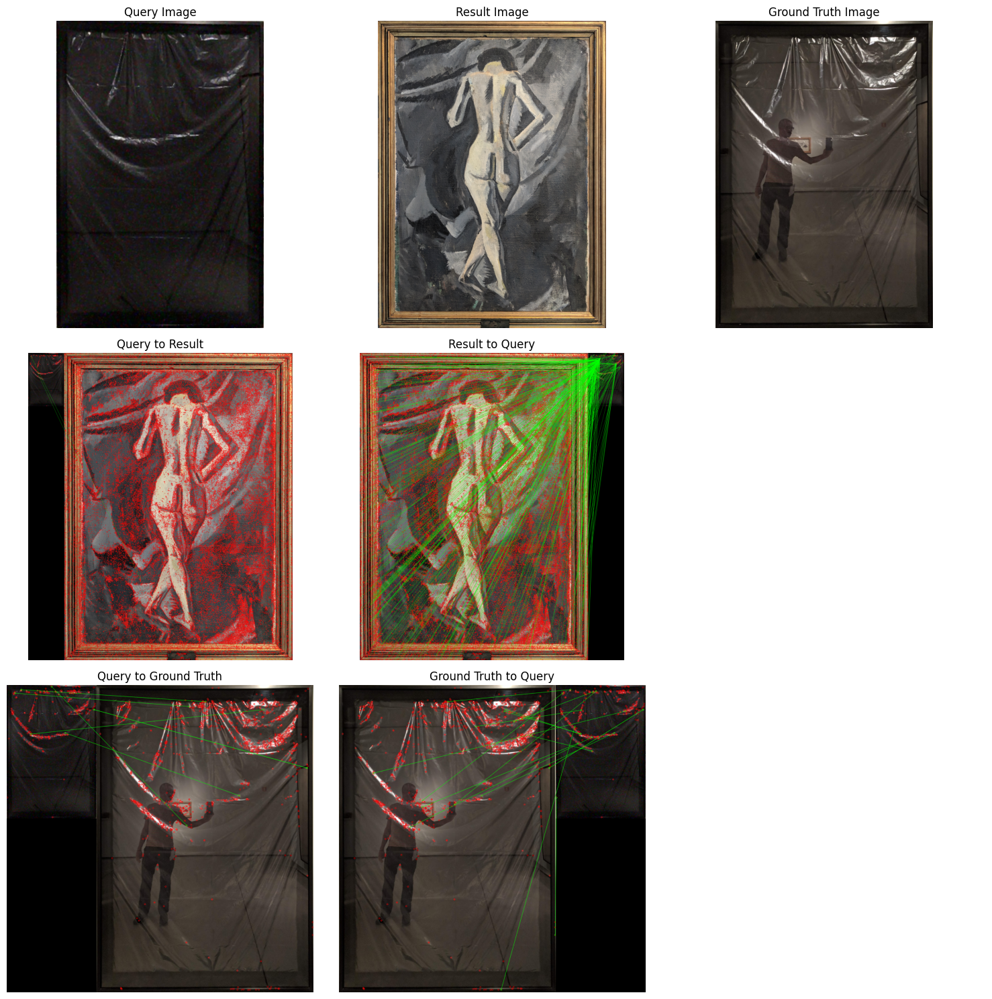

Query 9
 - Img 0
    GT: 155 | R: 155
 - Img 1
    GT: 258 | R: 258
Query 10
 - Img 0
    GT: 136 | R: 136
 - Img 1
    GT: 76 | R: 76
Query 11
 - Img 0
    GT: -1 | R: -1
Query 12
 - Img 0
    GT: -1 | R: -1
Query 13
 - Img 0
    GT: 53 | R: 53
Query 14
 - Img 0
    GT: -1 | R: -1
Query 15
 - Img 0
    GT: 12 | R: 12
Query 16
 - Img 0
    GT: 11 | R: -1
    Wrongly detected
[(-1, 1)]


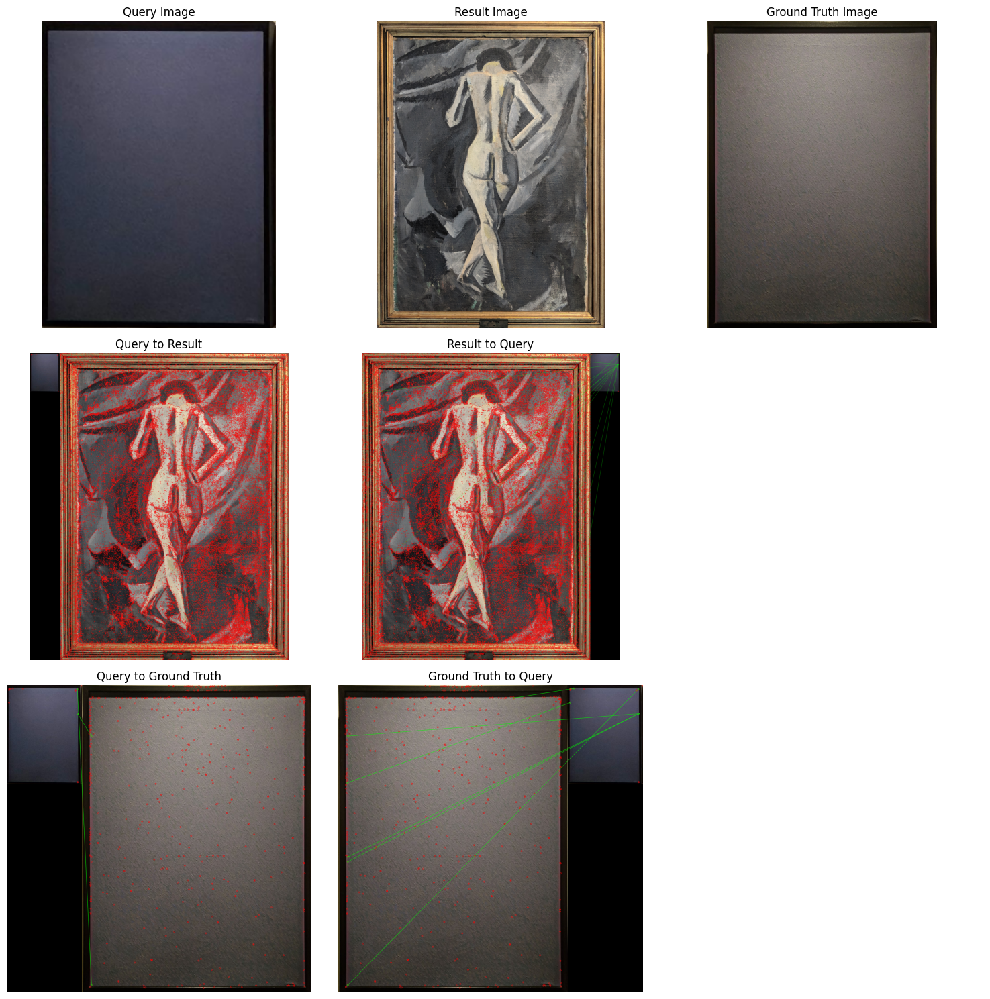

 - Img 1
    GT: 280 | R: 280
Query 17
 - Img 0
    GT: -1 | R: 128
    Wrongly detected
[(128, 0.32148760330578513), (268, 0.24462809917355371), (219, 0.24421487603305786), (75, 0.24008264462809917), (213, 0.21446280991735536), (157, 0.19834710743801653), (100, 0.19793388429752065), (204, 0.19586776859504132), (56, 0.19297520661157025), (47, 0.18925619834710744)]


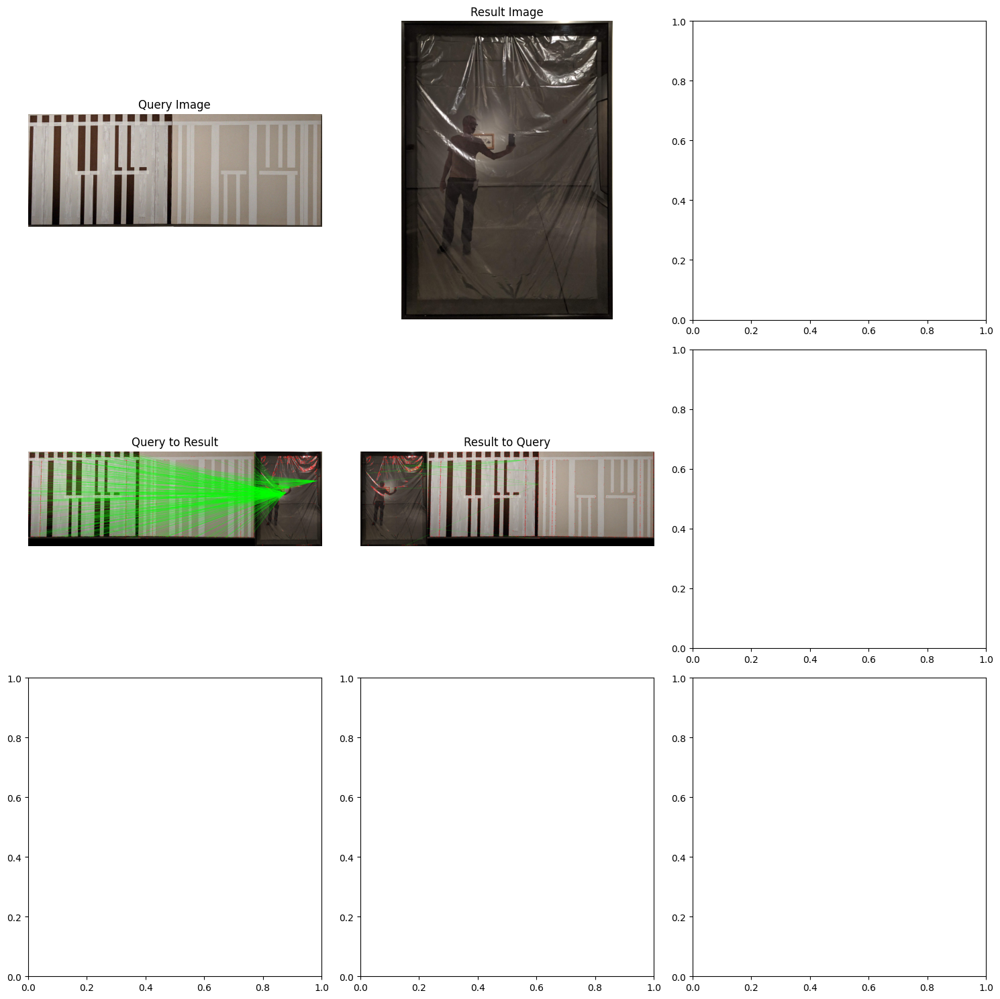

Query 18
 - Img 0
    GT: 182 | R: 182
 - Img 1
    GT: 252 | R: 252
Query 19
 - Img 0
    GT: -1 | R: -1
Query 20
 - Img 0
    GT: 272 | R: 272
 - Img 1
    GT: 117 | R: 117
Query 21
 - Img 0
    GT: -1 | R: 204
    Wrongly detected
[(204, 0.12474012474012475), (270, 0.09355509355509356), (263, 0.08523908523908524), (13, 0.06860706860706861), (90, 0.06652806652806653), (199, 0.06652806652806653), (282, 0.06652806652806653), (53, 0.06444906444906445), (150, 0.06444906444906445), (255, 0.062370062370062374)]


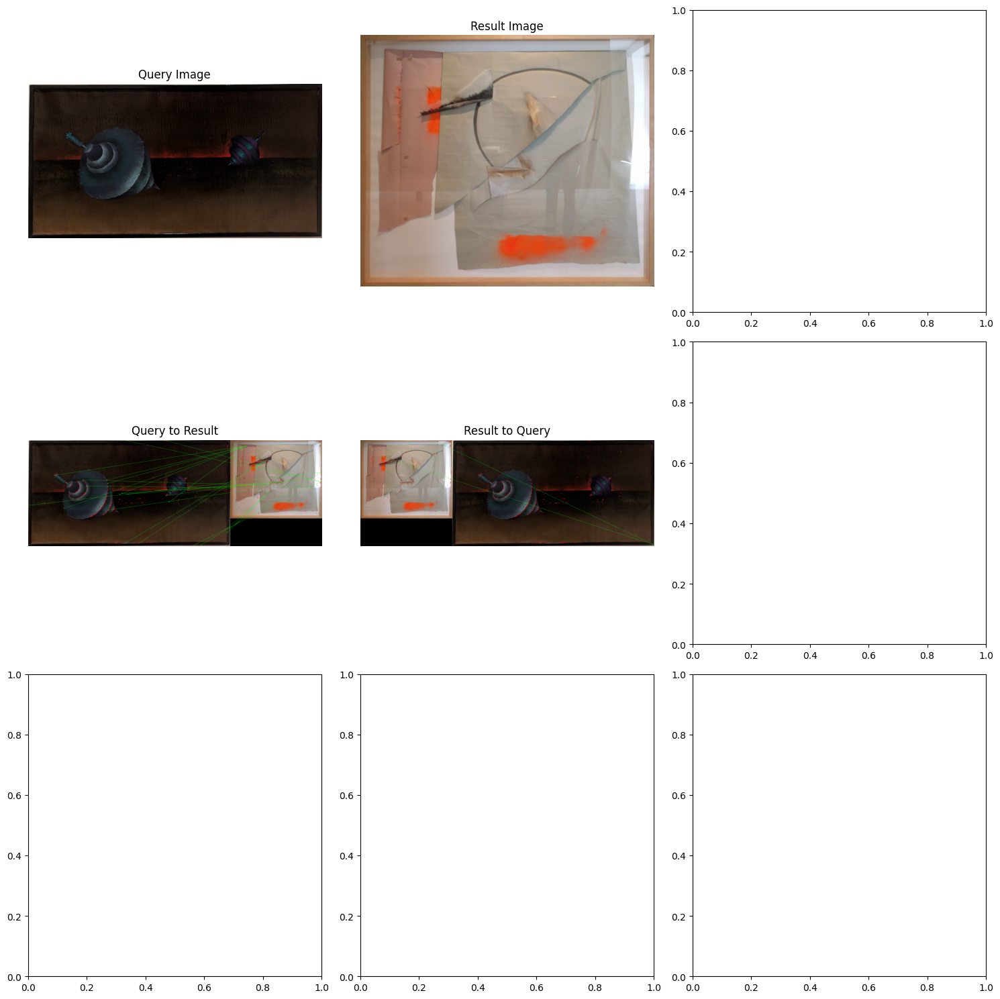

Query 22
 - Img 0
    GT: 242 | R: 242
Query 23
 - Img 0
    GT: 260 | R: 260
Query 24
 - Img 0
    GT: 94 | R: 94
 - Img 1
    GT: 132 | R: 132
Query 25
 - Img 0
    GT: 223 | R: 223
Query 26
 - Img 0
    GT: -1 | R: -1
Query 27
 - Img 0
    GT: 127 | R: 127
Query 28
 - Img 0
    GT: 47 | R: -1
    Wrongly detected
[(-1, 1)]


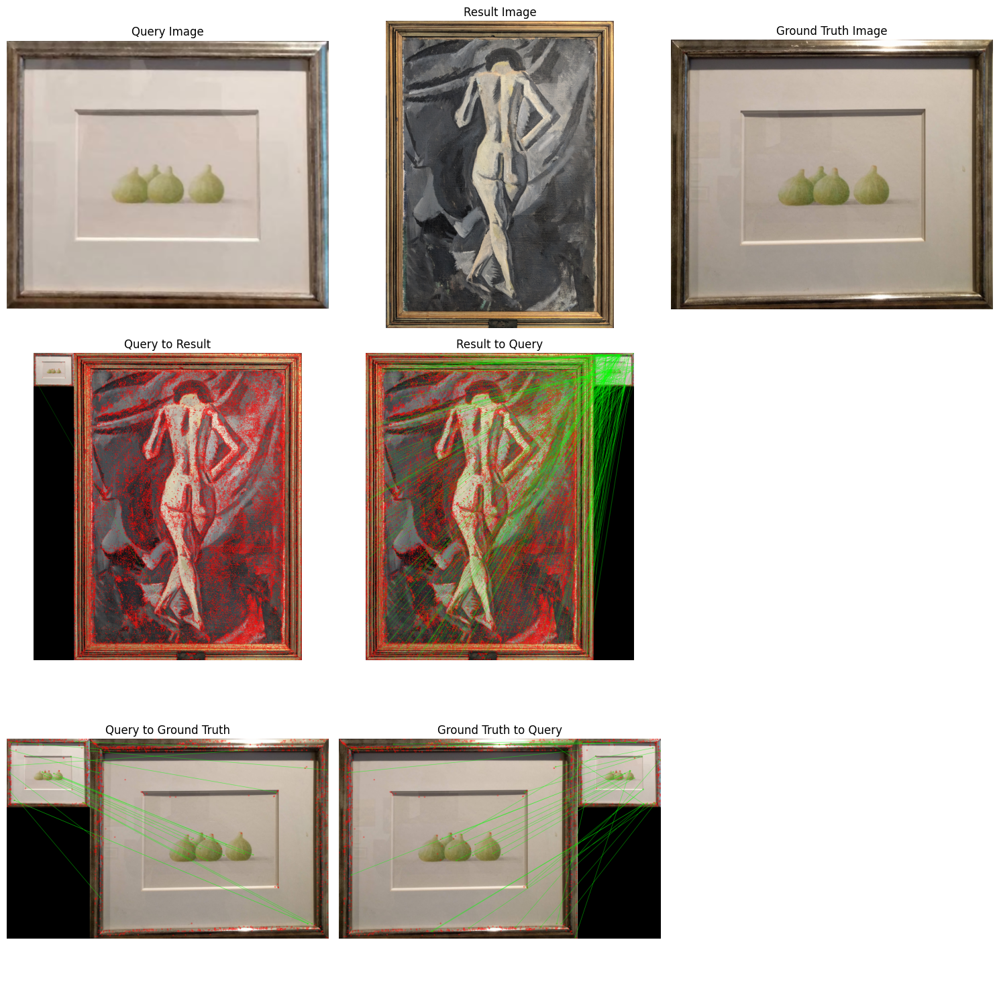

 - Img 1
    GT: 13 | R: 13
Query 29
 - Img 0
    GT: -1 | R: -1


In [35]:

for q_idx, (gt, result) in enumerate(zip(GT_QSD1_W4_LIST, results)):
    print(f"Query {q_idx}")
    for img_idx, (gt_r, result_r) in enumerate(zip(gt, result)):
        print(f" - Img {img_idx}")
        print(f"    GT: {gt_r} | R: {result_r[0][0]}")
        if gt_r != result_r[0][0]:
            print("    Wrongly detected")
            print(result_r)
            display_result(
                np.array(cropped_query_image_list_d1[q_idx][img_idx]),
                np.array(denoise_database_image[result_r[0][0]]),
                np.array(denoise_database_image[gt_r]),
                gt_r
            )
  



In [36]:
GT_mod = []
for element in GT_QSD1_W4_LIST:
    if len(element) == 2:
        GT_mod.append([element[0]])
        GT_mod.append([element[1]])
    else:
        GT_mod.append([element[0]])

results_mod = []
for element in results:
    if len(element) == 2:
        results_mod.append([x[0] for x in element[0]])
        results_mod.append([x[0] for x in element[1]])
    else:
        results_mod.append([x[0] for x in element[0]])

print(GT_mod)
print("#")
print(results_mod)

[[-1], [150], [48], [251], [32], [161], [81], [62], [38], [-1], [128], [155], [258], [136], [76], [-1], [-1], [53], [-1], [12], [11], [280], [-1], [182], [252], [-1], [272], [117], [-1], [242], [260], [94], [132], [223], [-1], [127], [47], [13], [-1]]
#
[[-1], [150, 95, 211, 75, 125, 107, 165, 141, 204, 79], [48, 128, 33, 211, 49, 138, 219, 236, 17, 115], [251, 89, 243, 114, 162, 121, 219, 238, 47, 128], [32, 270, 165, 115, 105, 5, 128, 180, 101, 7], [161, 211, 53, 212, 268, 246, 219, 17, 38, 157], [81, 268, 211, 53, 157, 141, 208, 159, 219, 17], [62, 67, 175, 123, 277, 285, 20, 159, 17, 33], [38, 83, 101, 188, 86, 157, 33, 115, 165, 131], [-1], [-1], [155, 141, 38, 263, 183, 199, 77, 179, 229, 5], [258, 185, 153, 67, 263, 142, 143, 107, 136, 152], [136, 43, 53, 236, 263, 8, 141, 186, 238, 17], [76, 17, 136, 175, 211, 238, 67, 43, 249, 263], [-1], [-1], [53, 55, 150, 178, 203, 2, 16, 32, 34, 65], [-1], [12, 164, 266, 67, 236, 109, 177, 268, 14, 17], [-1], [280, 258, 45, 229, 47, 144, 5

In [37]:
from src.metrics import MeanAveragePrecisionAtK

map = MeanAveragePrecisionAtK()

In [38]:
result = map.compute(GT_mod, results_mod, k=K)
print(result)

0.8717948717948718


## Final method